The first thing we're going to do is display an example song file.

In [2]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# load first bird song
filename = 	"SongFiles/LISP,060603,0748,37.74615N,107.68739W,6.wav"

# load audio as waveform, sampling rate as sr
y, sr = librosa.load(filename)

# need to figure out this line
plt.figure(figsize=(240, 120))

D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)

librosa.display.specshow(D, cmap='gray_r', y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Waveform example')

plt.show()

Next, let's try to use noise reduce to get a clearer picture of this song's data. Note that a programmatic determination of the noise window might be required. For now, we'll use observation to determine that window. 

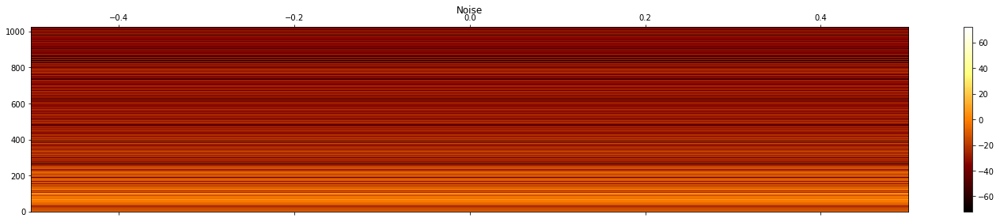

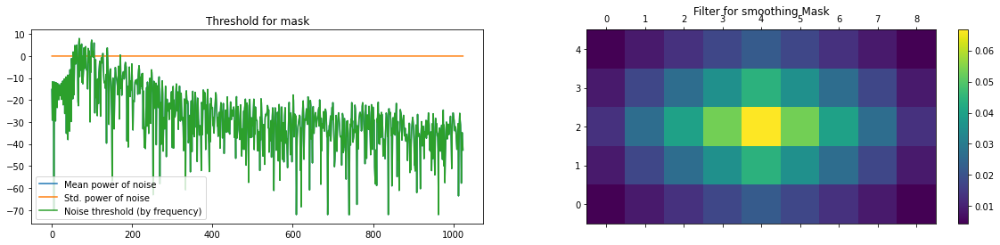

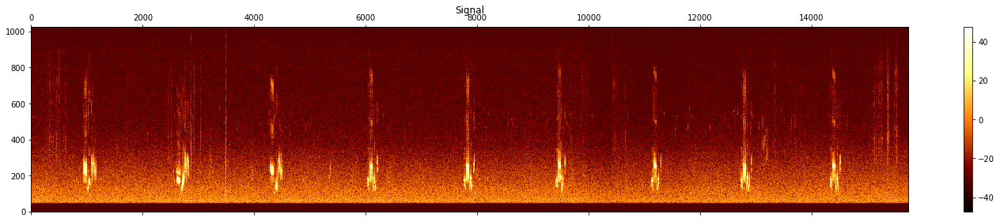

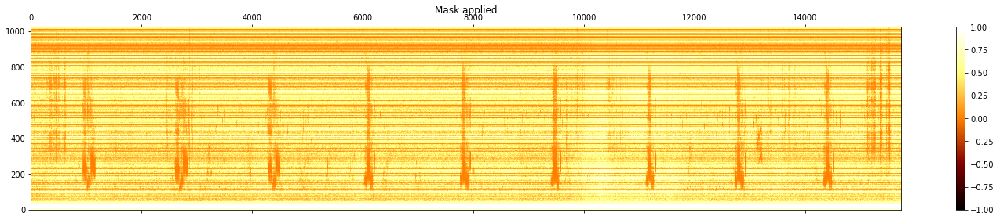

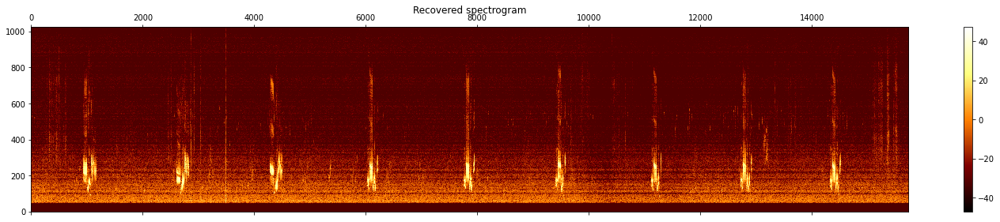

In [33]:
import noisereduce as nr
import scipy as sp
import wavefile as wv

# use wavefile module to convert wav from int to float
w = wv.load(filename)
data = w[1][0]

# load data (perhaps unnecessary as done previously)
# (deprecated) rate, data = sp.io.wavfile.read(filename)

# select section of data that is noise
noisy_part = data[1500:2000]

# perform noise reduction
reduced_noise = nr.reduce_noise(audio_clip=data, noise_clip=noisy_part, n_std_thresh=1.5, prop_decrease=1, verbose=True)

Next, we will convert the reduced noise data back to wav format so that we can emply pydub's split libraries

In [34]:
from scipy.io.wavfile import write

samplerate = 44100;
write("reduced_noise_file.wav", samplerate, data)

Pydub's split_on_silence function allows us to split the reduced noise file into chunks (which here correspond to bird syllables) based on a silence threshold

In [3]:
from pydub import AudioSegment
from pydub.silence import split_on_silence
from pydub.playback import play

# loading new audio into pydub
rnbirds = AudioSegment.from_wav("reduced_noise_file.wav")

# split into chunks using pydub
chunks = split_on_silence(
    # Use the loaded audio.
    rnbirds, 
    # Consider a chunk silent if it's less than the silence threshold
    silence_thresh = -30
)

for i, chunk in enumerate(chunks):
    chunk.export("chunk{0}.wav".format(i), format="wav")

Next, we will split each bird call into it's composite syllables. Fortunately, this can also be accomplished with pydub's split_on_silence method.

[1201.2, 3734.64, 4499.04, 7425.6, 8168.16, 11160.24, 11837.28, 14829.36, 15571.92, 18476.64, 19634.16, 20442.24, 20726.16, 24329.76, 25399.92, 28370.16, 29352.96, 32323.2, 33393.36, 36341.76, 37259.04, 39137.28, 39595.92, 41343.12, 41845.44, 43548.96, 44116.8, 45732.96, 46278.96, 47938.8, 48550.32, 50166.48, 50799.84, 51979.2, 52612.56, 53748.24, 54381.6, 54905.76]


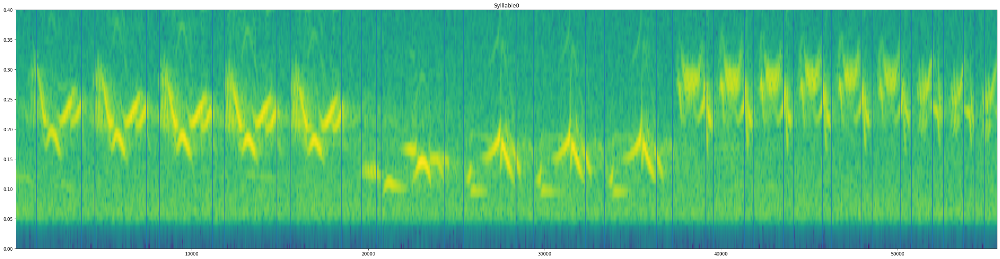

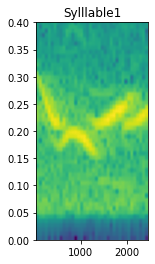

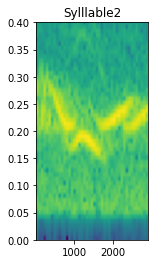

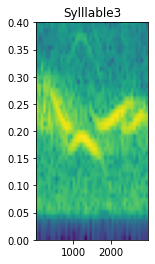

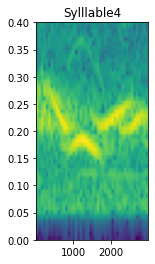

...

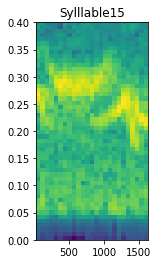

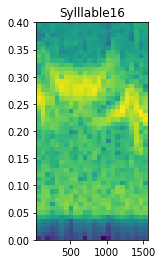

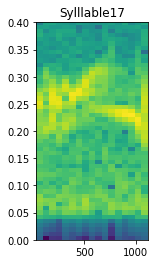

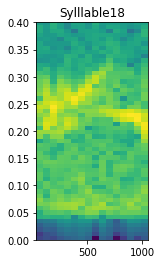

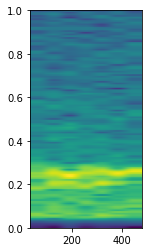

In [97]:
from matplotlib.pyplot import figure, plot, specgram
import matplotlib.pyplot as plt
from pydub.silence import detect_nonsilent
# for testing
import itertools

 

bird_call = AudioSegment.from_wav('./chunk1.wav')

syllables = split_on_silence(bird_call, min_silence_len=10, silence_thresh=-30, keep_silence=False)

# pydub functions for testing
nonsilent_ranges = detect_nonsilent(bird_call, min_silence_len=10, silence_thresh=-30)

markers = []

for rang in nonsilent_ranges:
    markers.append(rang[0] * 21.84)
    markers.append(rang[1] * 21.84)

# Plot the complete bird call
figure(figsize=(40, 10))

spec = specgram(x=bird_call.get_array_of_samples(), NFFT=256, Fs=2, noverlap=128, mode='magnitude')[3]
plt.ylim(0, .4)

print(markers)

for marker in markers:
    plt.axvline(x=marker)


# Plot each syllable

for i, syllable in enumerate(syllables):
    plt.title("Sylllable{0}".format(i))
    plt.ylim(0, .4)
    figure(figsize=(2, 4))

    specgram(syllable.get_array_of_samples(), NFFT=256, Fs=2, noverlap=128)

Finally, we calculate the frequency bandwidth and mean amplitude for 18 evenly dispersed points along each syllable.